In [1]:
import pandas as pd
import numpy as np

In [ ]:
df = pd.read_csv(
    'data/한국전력거래소_지역별 시간별 태양광 및 풍력 발전량_20241231.csv', encoding='cp949')

In [ ]:
df

,거래일자,거래시간,지역,연료원,전력거래량(MWh)
0,2024-01-01,1,강원도,태양광,0.000000
1,2024-01-01,2,강원도,태양광,0.000000
2,2024-01-01,3,강원도,태양광,0.000000
3,2024-01-01,4,강원도,태양광,0.000000
4,2024-01-01,5,강원도,태양광,0.000000
...,...,...,...,...,...
166891,2024-12-31,20,제주,풍력,25.056292
166892,2024-12-31,21,제주,풍력,22.991162
166893,2024-12-31,22,제주,풍력,19.606452
166894,2024-12-31,23,제주,풍력,20.195377


In [32]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 166896 entries, 0 to 166895
Data columns (total 5 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   거래일자        166896 non-null  object 
 1   거래시간        166896 non-null  int64  
 2   지역          166896 non-null  object 
 3   연료원         166896 non-null  object 
 4   전력거래량(MWh)  166896 non-null  float64
dtypes: float64(1), int64(1), object(3)
memory usage: 6.4+ MB


In [33]:
df['지역'] = df['지역'].astype('category')

In [34]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 166896 entries, 0 to 166895
Data columns (total 5 columns):
 #   Column      Non-Null Count   Dtype   
---  ------      --------------   -----   
 0   거래일자        166896 non-null  object  
 1   거래시간        166896 non-null  int64   
 2   지역          166896 non-null  category
 3   연료원         166896 non-null  object  
 4   전력거래량(MWh)  166896 non-null  float64 
dtypes: category(1), float64(1), int64(1), object(2)
memory usage: 5.3+ MB


In [35]:
print(list(df['지역'].unique()))

['강원도', '경기도', '경상남도', '경상북도', '광주시', '대구시', '대전시', '부산시', '서울시', '세종시', '울산시', '인천시', '전라남도', '전라북도', '제주도', '충청남도', '충청북도', '육지', '제주']


In [36]:
weather = pd.read_csv('data/OBS_ASOS_DD_20250611134510.csv', encoding='cp949')
weather['지점명'] = weather['지점명'].astype('category')
weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5856 entries, 0 to 5855
Data columns (total 62 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   지점                   5856 non-null   int64   
 1   지점명                  5856 non-null   category
 2   일시                   5856 non-null   object  
 3   평균기온(°C)             5853 non-null   float64 
 4   최저기온(°C)             5856 non-null   float64 
 5   최저기온 시각(hhmi)        5856 non-null   int64   
 6   최고기온(°C)             5856 non-null   float64 
 7   최고기온 시각(hhmi)        5856 non-null   int64   
 8   강수 계속시간(hr)          1636 non-null   float64 
 9   10분 최다 강수량(mm)       1486 non-null   float64 
 10  10분 최다강수량 시각(hhmi)   1004 non-null   float64 
 11  1시간 최다강수량(mm)        1486 non-null   float64 
 12  1시간 최다 강수량 시각(hhmi)  1034 non-null   float64 
 13  일강수량(mm)             2507 non-null   float64 
 14  최대 순간 풍속(m/s)        5853 non-null   float64 
 15  최대 순간 풍속 풍향(16방위)    

In [48]:
print(list(weather['지점명'].unique()))

['서울시', '인천시', '대전시', '경상북도', '전라북도', '울산시', '광주시', '부산시', '충청남도', '제주', '육지', '강원도', '충청북도', '세종시', '전라남도', '경상남도']


In [ ]:
mapping = {
    '서울시': '서울',
    '인천시': '인천',
    '대전시': '대전',
    '경상북도': '안동',
    '전라북도': '전주',
    '울산시': '울산',
    '광주시': '광주',
    '부산시': '부산',
    '충청남도': '홍성',
    '제주도': '제주',
    '경기도': '양평',
    '강원도': '정선군',
    '충청북도': '보은',
    '세종시': '세종',
    '전라남도': '장흥',
    '경상남도': '합천',
    '제주': '제주',
    '육지': '양평',
}

In [41]:
weather['지점명'] = weather['지점명'].replace(mapping.values(), mapping.keys())

/var/folders/qh/y7mzyw6s3w300lq_vkfs6gq80000gn/T/ipykernel_8291/361626347.py:1: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  weather['지점명'] = weather['지점명'].replace(mapping.values(), mapping.keys())


In [42]:
weather

,지점,지점명,일시,평균기온(°C),최저기온(°C),최저기온 시각(hhmi),최고기온(°C),최고기온 시각(hhmi),강수 계속시간(hr),10분 최다 강수량(mm),...,0.5m 지중온도(°C),1.0m 지중온도(°C),1.5m 지중온도(°C),3.0m 지중온도(°C),5.0m 지중온도(°C),합계 대형증발량(mm),합계 소형증발량(mm),9-9강수(mm),기사,안개 계속시간(hr)
0,108,서울시,2024-01-01,3.3,-0.3,402,7.3,1255,2.92,NaN,...,2.8,6.3,9.9,15.7,18.1,0.9,1.3,0.0,-{박무}-{박무}{강도1}0300-{박무}{강도1}0600-{박무}{강도0}090...,NaN
1,108,서울시,2024-01-02,2.9,2.2,622,4.3,1409,1.58,NaN,...,2.8,6.1,9.7,15.6,18.0,0.7,1.0,0.1,-{비}-0105. -{박무}-{박무}{강도0}0300-{박무}{강도0}0600-0...,NaN
2,108,서울시,2024-01-03,1.8,-1.1,2350,4.0,1320,6.25,NaN,...,2.8,6.0,9.6,15.5,18.0,0.5,0.7,0.5,{비}0605-{비}{강도0}0900-{싸락눈}0915-{비}0950-1010. {...,NaN
3,108,서울시,2024-01-04,1.4,-3.3,715,4.7,1556,NaN,NaN,...,2.8,5.9,9.5,15.4,17.9,0.7,1.1,0.0,-{박무}-{박무}{강도0}0300-0445. {박무}0505-{박무}{강도0}06...,NaN
4,108,서울시,2024-01-05,5.0,1.4,2356,9.1,1439,0.42,NaN,...,2.8,5.8,9.3,15.3,17.9,1.2,1.7,NaN,{박무}0220-{박무}{강도0}0300-{박무}{강도0}0600-{박무}{강도0}...,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5851,285,경상남도,2024-12-27,1.8,-2.4,727,6.2,1306,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5852,285,경상남도,2024-12-28,0.3,-4.1,2351,4.6,1322,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5853,285,경상남도,2024-12-29,0.3,-4.6,248,7.9,1307,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5854,285,경상남도,2024-12-30,4.8,-2.7,151,11.5,1506,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [43]:
df = df.merge(weather, left_on=['지역', '거래일자'],
              right_on=['지점명', '일시'], how='left')

In [44]:
df

,거래일자,거래시간,지역,연료원,전력거래량(MWh),지점,지점명,일시,평균기온(°C),최저기온(°C),...,0.5m 지중온도(°C),1.0m 지중온도(°C),1.5m 지중온도(°C),3.0m 지중온도(°C),5.0m 지중온도(°C),합계 대형증발량(mm),합계 소형증발량(mm),9-9강수(mm),기사,안개 계속시간(hr)
0,2024-01-01,1,강원도,태양광,0.000000,217.0,강원도,2024-01-01,0.6,-0.8,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2024-01-01,2,강원도,태양광,0.000000,217.0,강원도,2024-01-01,0.6,-0.8,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2024-01-01,3,강원도,태양광,0.000000,217.0,강원도,2024-01-01,0.6,-0.8,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2024-01-01,4,강원도,태양광,0.000000,217.0,강원도,2024-01-01,0.6,-0.8,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2024-01-01,5,강원도,태양광,0.000000,217.0,강원도,2024-01-01,0.6,-0.8,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
166891,2024-12-31,20,제주,풍력,25.056292,184.0,제주,2024-12-31,8.2,5.6,...,11.4,12.7,13.5,18.7,19.8,2.1,3.0,NaN,NaN,NaN
166892,2024-12-31,21,제주,풍력,22.991162,184.0,제주,2024-12-31,8.2,5.6,...,11.4,12.7,13.5,18.7,19.8,2.1,3.0,NaN,NaN,NaN
166893,2024-12-31,22,제주,풍력,19.606452,184.0,제주,2024-12-31,8.2,5.6,...,11.4,12.7,13.5,18.7,19.8,2.1,3.0,NaN,NaN,NaN
166894,2024-12-31,23,제주,풍력,20.195377,184.0,제주,2024-12-31,8.2,5.6,...,11.4,12.7,13.5,18.7,19.8,2.1,3.0,NaN,NaN,NaN


In [46]:
df.to_csv('data/merged_data.csv', index=False, encoding='utf-8-sig')

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import koreanize_matplotlib

In [3]:
df = pd.read_csv('data/merged_data.csv', encoding='utf-8-sig')

In [4]:
df['지역'] = df['지역'].astype('category')
df['지점명'] = df['지점명'].astype('category')
df['연료원'] = df['연료원'].astype('category')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 166896 entries, 0 to 166895
Data columns (total 67 columns):
 #   Column               Non-Null Count   Dtype   
---  ------               --------------   -----   
 0   거래일자                 166896 non-null  object  
 1   거래시간                 166896 non-null  int64   
 2   지역                   166896 non-null  category
 3   연료원                  166896 non-null  category
 4   전력거래량(MWh)           166896 non-null  float64 
 5   지점                   140544 non-null  float64 
 6   지점명                  140544 non-null  category
 7   일시                   140544 non-null  object  
 8   평균기온(°C)             140472 non-null  float64 
 9   최저기온(°C)             140544 non-null  float64 
 10  최저기온 시각(hhmi)        140544 non-null  float64 
 11  최고기온(°C)             140544 non-null  float64 
 12  최고기온 시각(hhmi)        140544 non-null  float64 
 13  강수 계속시간(hr)          39264 non-null   float64 
 14  10분 최다 강수량(mm)       35664 non-null   float64 
 15  

In [17]:
df[df['연료원'] == '풍력']['지역']

149328    육지
149329    육지
149330    육지
149331    육지
149332    육지
          ..
166891    제주
166892    제주
166893    제주
166894    제주
166895    제주
Name: 지역, Length: 17568, dtype: category
Categories (19, object): ['강원도', '경기도', '경상남도', '경상북도', ..., '제주', '제주도', '충청남도', '충청북도']

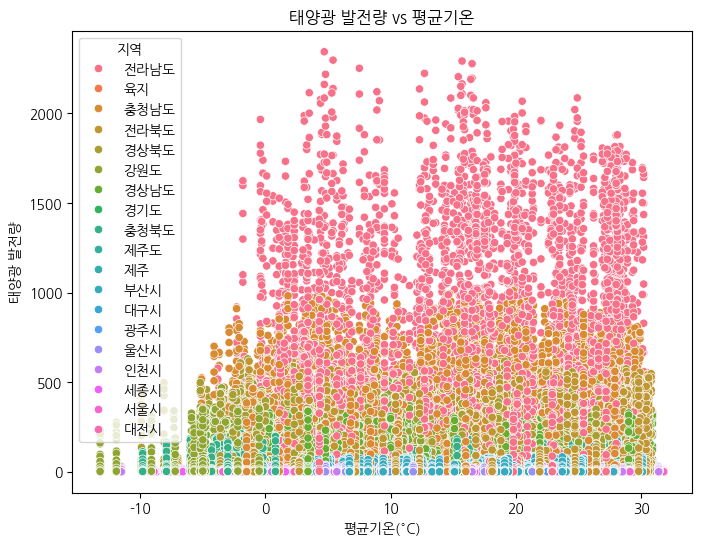

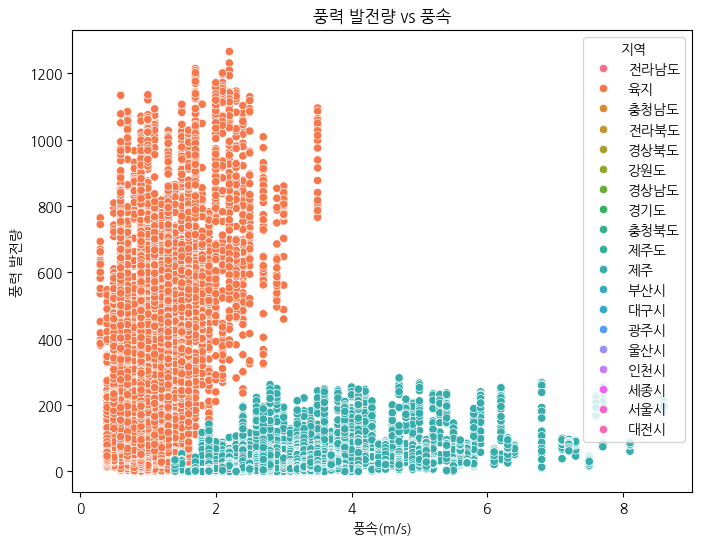

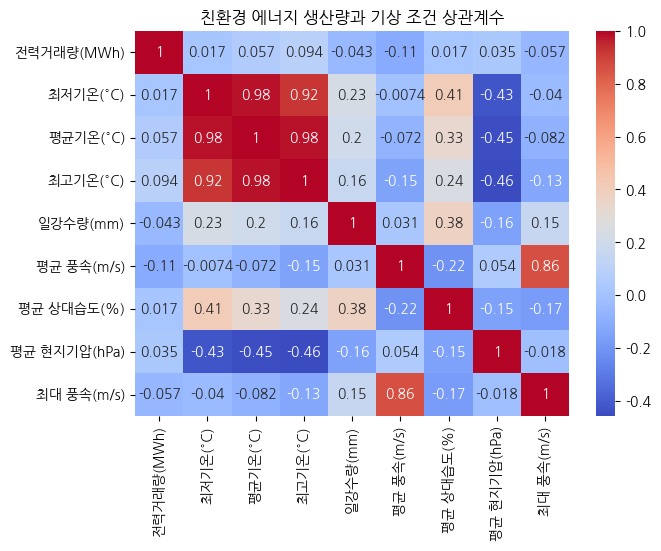

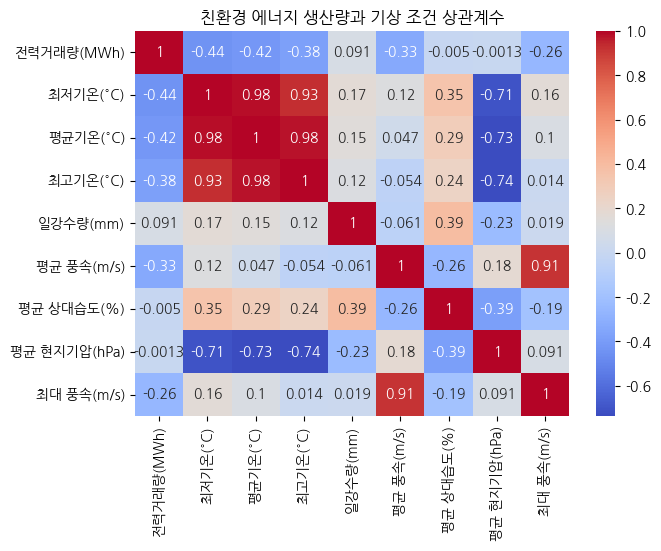

In [5]:
import seaborn as sns
import matplotlib.pyplot as plt

# 태양광 발전량과 기온의 상관관계
plt.figure(figsize=(8, 6))
sns.scatterplot(data=df[df['연료원'] == '태양광'],
                x='평균기온(°C)', y='전력거래량(MWh)', hue='지역')
plt.title('태양광 발전량 vs 평균기온')
plt.xlabel('평균기온(°C)')
plt.ylabel('태양광 발전량')
plt.show()

# 풍력 발전량과 풍속의 상관관계
plt.figure(figsize=(8, 6))
sns.scatterplot(data=df[df['연료원'] == '풍력'],
                x='평균 풍속(m/s)', y='전력거래량(MWh)', hue='지역')
plt.title('풍력 발전량 vs 풍속')
plt.xlabel('풍속(m/s)')
plt.ylabel('풍력 발전량')
plt.show()

# 여러 변수 간 상관계수 히트맵(sun)
corr_cols = ['전력거래량(MWh)', '최저기온(°C)', '평균기온(°C)', '최고기온(°C)', '일강수량(mm)',
             '평균 풍속(m/s)', '평균 상대습도(%)', '평균 현지기압(hPa)', '최대 풍속(m/s)']
corr = df[df['연료원'] == '태양광'][corr_cols].corr()
plt.figure(figsize=(7, 5))
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.title('친환경 에너지 생산량과 기상 조건 상관계수')
plt.show()
# 여러 변수 간 상관계수 히트맵(wind)
corr_cols = ['전력거래량(MWh)', '최저기온(°C)', '평균기온(°C)', '최고기온(°C)', '일강수량(mm)',
             '평균 풍속(m/s)', '평균 상대습도(%)', '평균 현지기압(hPa)', '최대 풍속(m/s)']
corr = df[df['연료원'] == '풍력'][corr_cols].corr()
plt.figure(figsize=(7, 5))
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.title('친환경 에너지 생산량과 기상 조건 상관계수')
plt.show()

In [6]:
df['거래일시'] = df.apply(lambda x: str(x['거래일자']) + ' ' +
                      str(x['거래시간']) + ':00', axis=1)

In [7]:
import datetime


def fix_24_hour(dt_str):
  if dt_str.endswith('24:00'):
    date_part = dt_str[:10]
    next_day = (datetime.datetime.strptime(date_part, '%Y-%m-%d') +
                datetime.timedelta(days=1)).strftime('%Y-%m-%d')
    return next_day + ' 00:00'
  return dt_str


df['거래일시'] = df['거래일시'].apply(fix_24_hour)
df['거래일시'] = pd.to_datetime(df['거래일시'], format='%Y-%m-%d %H:%M')

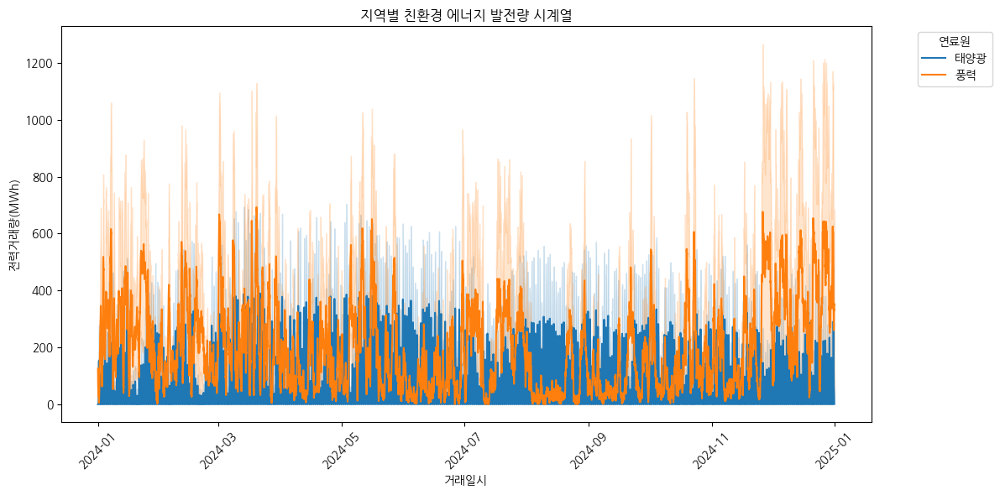

In [10]:
import seaborn as sns

# 거래일시, 지역별 전력거래량(MWh) 시각화
plt.figure(figsize=(12, 6))
sns.lineplot(data=df,
             x='거래일시', y='전력거래량(MWh)', hue='연료원')
plt.title('지역별 친환경 에너지 발전량 시계열')
plt.xlabel('거래일시')
plt.ylabel('전력거래량(MWh)')
plt.xticks(rotation=45)
plt.legend(title='연료원', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

In [9]:
import plotly.express as px

# 지역별 총 발전량 계산
region_order = (
  df.groupby('지역')['전력거래량(MWh)'].sum()
  .sort_values(ascending=False)
  .index.tolist()
)

# 카테고리 순서 지정 (적은 지역이 먼저, 많은 지역이 뒤)
df['지역'] = df['지역'].cat.reorder_categories(region_order, ordered=True)

fig = px.line(
  df,
  x='거래일시',
  y='전력거래량(MWh)',
  color='지역',
  facet_row='연료원',
  title='지역별 친환경 에너지 발전량 시계열',
  category_orders={'지역': region_order},
  hover_data=[
    '평균기온(°C)', '최저기온(°C)', '최고기온(°C)',
    '일강수량(mm)', '평균 풍속(m/s)', '평균 상대습도(%)'
  ]
)
fig.update_layout(
  xaxis_title='거래일시',
  yaxis_title='전력거래량(MWh)',
  legend_title='연료원',
  height=900,
)
fig.show()
fig.write_html('region_energy_timeseries.html')

/var/folders/qh/y7mzyw6s3w300lq_vkfs6gq80000gn/T/ipykernel_72773/3606391048.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby('지역')['전력거래량(MWh)'].sum()


In [37]:
df[df['거래일자'] == "2024-02-20"][['평균기온(°C)', '일강수량(mm)', '최대 순간 풍속(m/s)']]

,평균기온(°C),일강수량(mm),최대 순간 풍속(m/s)
20400,2.2,2.7,6.2
20401,2.2,2.7,6.2
20402,2.2,2.7,6.2
20403,2.2,2.7,6.2
20404,2.2,2.7,6.2
...,...,...,...
159331,11.0,4.7,11.8
159332,11.0,4.7,11.8
159333,11.0,4.7,11.8
159334,11.0,4.7,11.8


In [68]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

# 사이킷런으로 태양광 발전 예측 모델 학습

# 태양광 데이터 추출
X = df[df['연료원'] == '태양광'][[
    '평균기온(°C)', '일강수량(mm)', '평균 상대습도(%)', '강수 계속시간(hr)',
    '최고기온(°C)', '거래시간']]
y = df[df['연료원'] == '태양광']['전력거래량(MWh)'].fillna(0)

# 특성 추가 - 시간 관련 특성 (태양광 발전에 매우 중요)
X = X.copy()
# 거래일시를 통해 월, 일 정보 추가
dates = pd.to_datetime(df[df['연료원'] == '태양광']['거래일자'])
X['월'] = dates.dt.month
X['일'] = dates.dt.day
X['계절'] = dates.dt.month.map({1: 1, 2: 1, 3: 1, 4: 2, 5: 2, 6: 2,
                             7: 3, 8: 3, 9: 3, 10: 4, 11: 4, 12: 4})  # 1:겨울, 2:봄, 3:여름, 4:가을
X['지역'] = df[df['연료원'] == '태양광']['지역'].astype(
    'category').cat.codes  # 지역을 숫자로 인코딩
X['시간_정규화'] = X['거래시간'] / 24  # 시간 정규화

# 결측치 채우기
X = X.fillna(0)

# 훈련/테스트 데이터 분할
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42)

# 랜덤포레스트 모델
model = RandomForestRegressor(
    n_estimators=200,  # 트리 개수
    max_depth=25,      # 트리 깊이
    random_state=42
)

# 모델 훈련
model.fit(X_train, y_train)

# 모델 평가
train_score = model.score(X_train, y_train)
test_score = model.score(X_test, y_test)
print(f"태양광 모델 훈련 세트 R² 점수: {train_score:.4f}")
print(f"태양광 모델 테스트 세트 R² 점수: {test_score:.4f}")

# 중요 변수 확인
feature_importance = pd.DataFrame({
    '특성': X.columns,
    '중요도': model.feature_importances_
}).sort_values('중요도', ascending=False)

print("\n특성 중요도:")
print(feature_importance)

태양광 모델 훈련 세트 R² 점수: 0.9960
태양광 모델 테스트 세트 R² 점수: 0.9712

특성 중요도:
             특성       중요도
9            지역  0.302600
5          거래시간  0.259055
10       시간_정규화  0.233703
1      일강수량(mm)  0.048527
4      최고기온(°C)  0.043870
2    평균 상대습도(%)  0.040927
6             월  0.017791
3   강수 계속시간(hr)  0.017707
7             일  0.017383
0      평균기온(°C)  0.013455
8            계절  0.004981


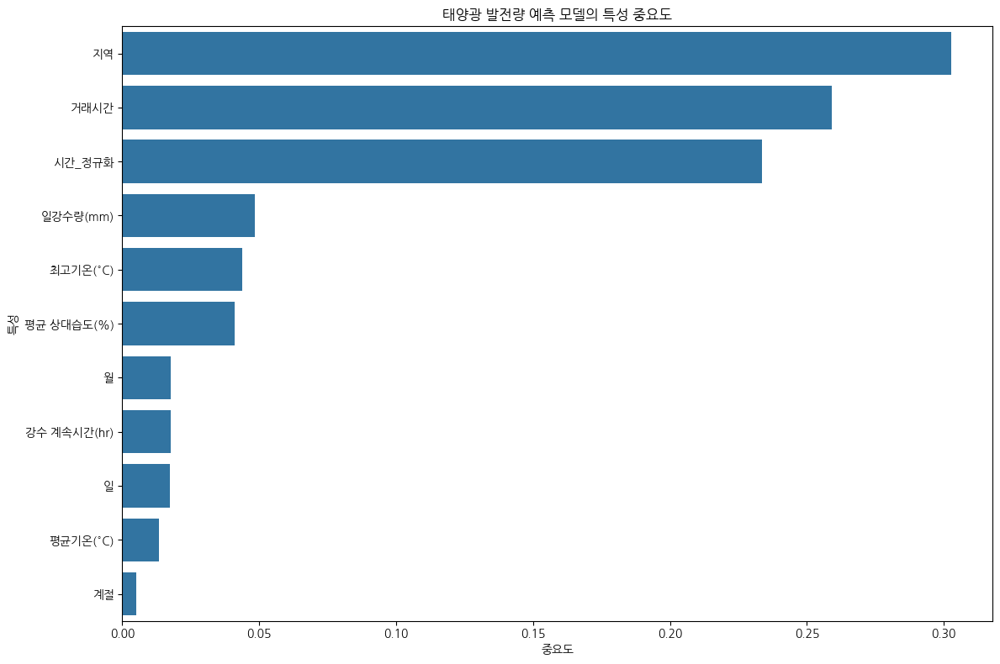

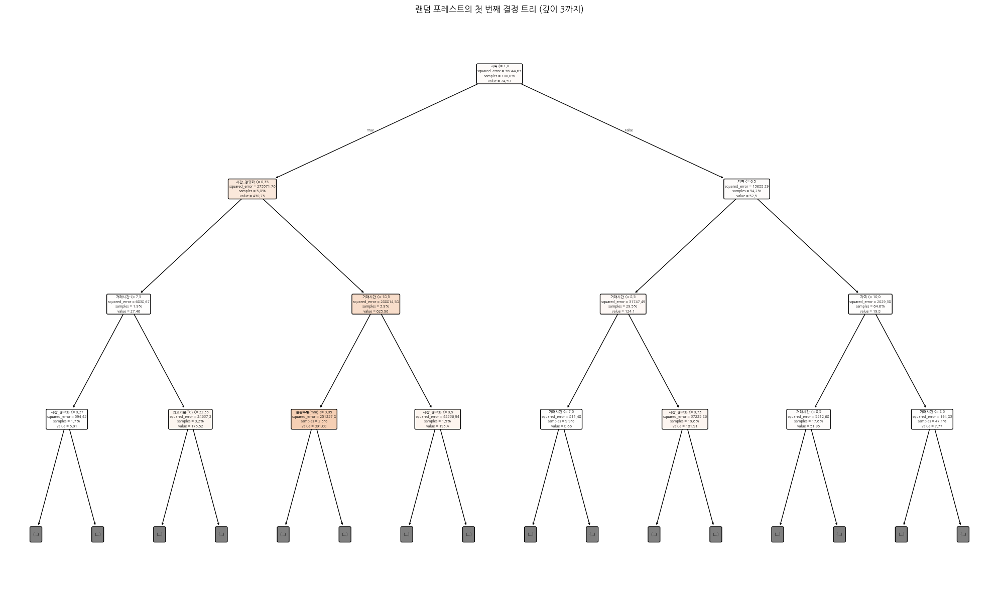

In [69]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.tree import plot_tree

# 특성 중요도 시각화
plt.figure(figsize=(12, 8))
sns.barplot(x='중요도', y='특성', data=feature_importance)
plt.title('태양광 발전량 예측 모델의 특성 중요도')
plt.xlabel('중요도')
plt.ylabel('특성')
plt.tight_layout()
plt.show()

# 랜덤 포레스트의 샘플 트리 시각화 (전체 트리를 시각화하는 것은 복잡하므로 첫 번째 트리만)
plt.figure(figsize=(20, 12))
plot_tree(model.estimators_[0],
          feature_names=X.columns,
          filled=True,
          max_depth=3,  # 가독성을 위해 깊이 제한
          rounded=True,
          proportion=True,
          precision=2)
plt.title('랜덤 포레스트의 첫 번째 결정 트리 (깊이 3까지)')
plt.tight_layout()
plt.show()

In [12]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

# 사이킷런으로 태양광 발전 예측 모델 학습

# 풍력 데이터 추출
X = df[df['연료원'] == '풍력'][[
    '평균기온(°C)', '일강수량(mm)', '평균 상대습도(%)', '강수 계속시간(hr)',
    '최고기온(°C)', '거래시간']]
y = df[df['연료원'] == '풍력']['전력거래량(MWh)'].fillna(0)

# 특성 추가 - 시간 관련 특성 (풍력 발전에 매우 중요)
X = X.copy()
# 거래일시를 통해 월, 일 정보 추가
dates = pd.to_datetime(df[df['연료원'] == '풍력']['거래일자'])
X['월'] = dates.dt.month
X['일'] = dates.dt.day
X['계절'] = dates.dt.month.map({1: 1, 2: 1, 3: 1, 4: 2, 5: 2, 6: 2,
                             7: 3, 8: 3, 9: 3, 10: 4, 11: 4, 12: 4})  # 1:겨울, 2:봄, 3:여름, 4:가을
X['지역'] = df[df['연료원'] == '풍력']['지역'].astype(
    'category').cat.codes  # 지역을 숫자로 인코딩
X['시간_정규화'] = X['거래시간'] / 24  # 시간 정규화

# 결측치 채우기
X = X.fillna(0)

# 훈련/테스트 데이터 분할
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42)

# 랜덤포레스트 모델
model = RandomForestRegressor(
    n_estimators=200,  # 트리 개수
    max_depth=25,      # 트리 깊이
    random_state=42
)

# 모델 훈련
model.fit(X_train, y_train)

# 모델 평가
train_score = model.score(X_train, y_train)
test_score = model.score(X_test, y_test)
print(f"풍력 모델 훈련 세트 R² 점수: {train_score:.4f}")
print(f"풍력 모델 테스트 세트 R² 점수: {test_score:.4f}")

# 중요 변수 확인
feature_importance = pd.DataFrame({
    '특성': X.columns,
    '중요도': model.feature_importances_
}).sort_values('중요도', ascending=False)

print("\n특성 중요도:")
print(feature_importance)

풍력 모델 훈련 세트 R² 점수: 0.9977
풍력 모델 테스트 세트 R² 점수: 0.9821

특성 중요도:
             특성       중요도
9            지역  0.361240
4      최고기온(°C)  0.191283
2    평균 상대습도(%)  0.080912
6             월  0.077877
7             일  0.076479
1      일강수량(mm)  0.070111
0      평균기온(°C)  0.054815
10       시간_정규화  0.038665
5          거래시간  0.038377
8            계절  0.008503
3   강수 계속시간(hr)  0.001739


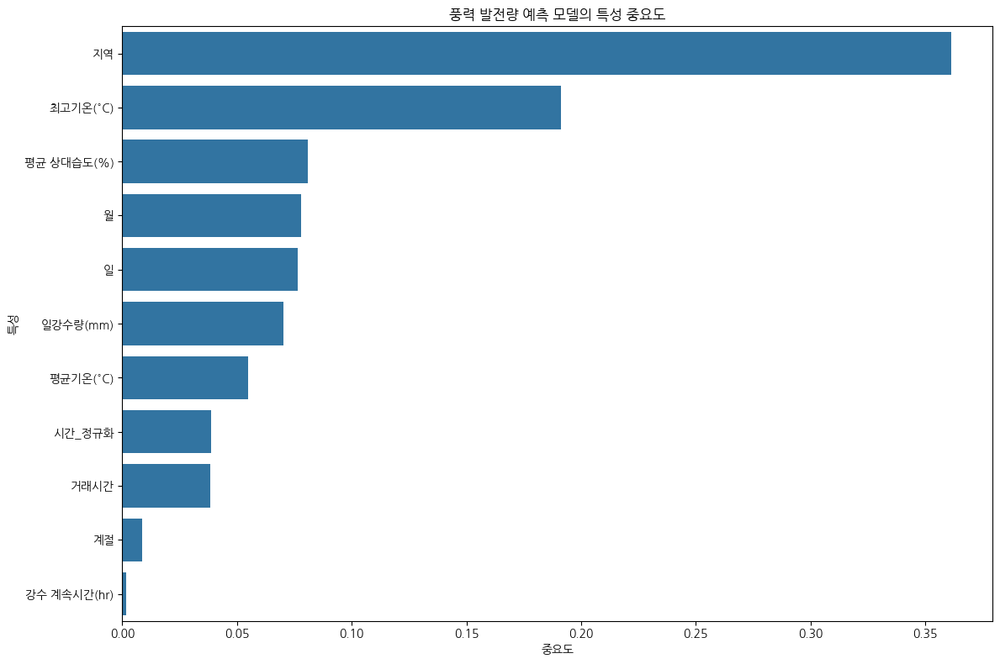

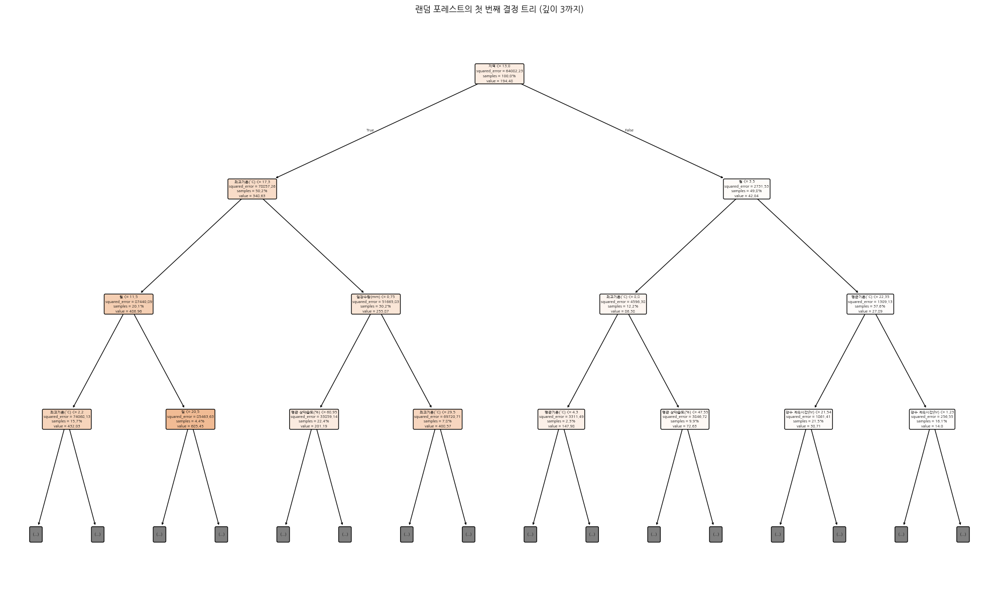

In [13]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.tree import plot_tree

# 특성 중요도 시각화
plt.figure(figsize=(12, 8))
sns.barplot(x='중요도', y='특성', data=feature_importance)
plt.title('풍력 발전량 예측 모델의 특성 중요도')
plt.xlabel('중요도')
plt.ylabel('특성')
plt.tight_layout()
plt.show()

# 랜덤 포레스트의 샘플 트리 시각화 (전체 트리를 시각화하는 것은 복잡하므로 첫 번째 트리만)
plt.figure(figsize=(20, 12))
plot_tree(model.estimators_[0],
          feature_names=X.columns,
          filled=True,
          max_depth=3,  # 가독성을 위해 깊이 제한
          rounded=True,
          proportion=True,
          precision=2)
plt.title('랜덤 포레스트의 첫 번째 결정 트리 (깊이 3까지)')
plt.tight_layout()
plt.show()

/Users/obt/gitRepos/FastAPI-ApplicationProgrammingDevelopment/.venv/lib/python3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning:

urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020



Epoch 1/50


/Users/obt/gitRepos/FastAPI-ApplicationProgrammingDevelopment/.venv/lib/python3.9/site-packages/keras/src/layers/core/dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



1494/1494 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step - loss: 0.5409 - mae: 0.4183 - root_mean_squared_error: 0.7207 - val_loss: 0.1298 - val_mae: 0.1577 - val_root_mean_squared_error: 0.3603
Epoch 2/50
1494/1494 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1960 - mae: 0.2174 - root_mean_squared_error: 0.4425 - val_loss: 0.1028 - val_mae: 0.1470 - val_root_mean_squared_error: 0.3206
Epoch 3/50
1494/1494 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 0.1678 - mae: 0.1912 - root_mean_squared_error: 0.4095 - val_loss: 0.0900 - val_mae: 0.1210 - val_root_mean_squared_error: 0.3000
Epoch 4/50
1494/1494 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 0.1410 - mae: 0.1741 - root_mean_squared_error: 0.3752 - val_loss: 0.1106 - val_mae: 0.1274 - val_root_mean_squared_error: 0.3326
Epoch 5/50
1494/1494 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 0.1395 - mae: 0.1714 - root_mean_squared_error: 0.3734 - val_loss: 0.0845 - val_mae: 0.1197 - val_root_mean_squared_error: 0.2906
Epoch 6/50
1494/1494 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/st

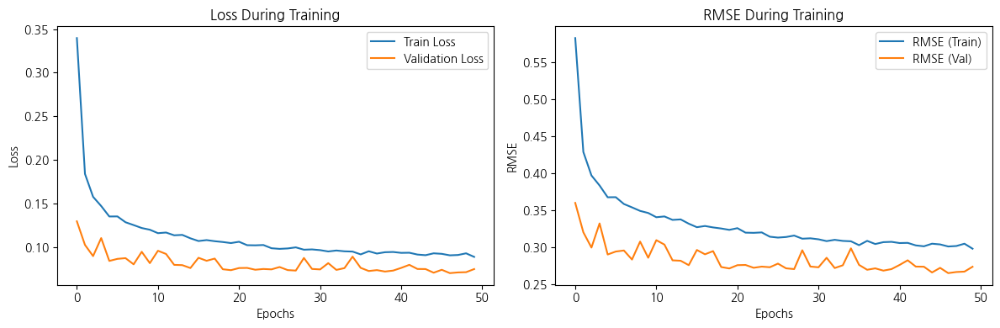

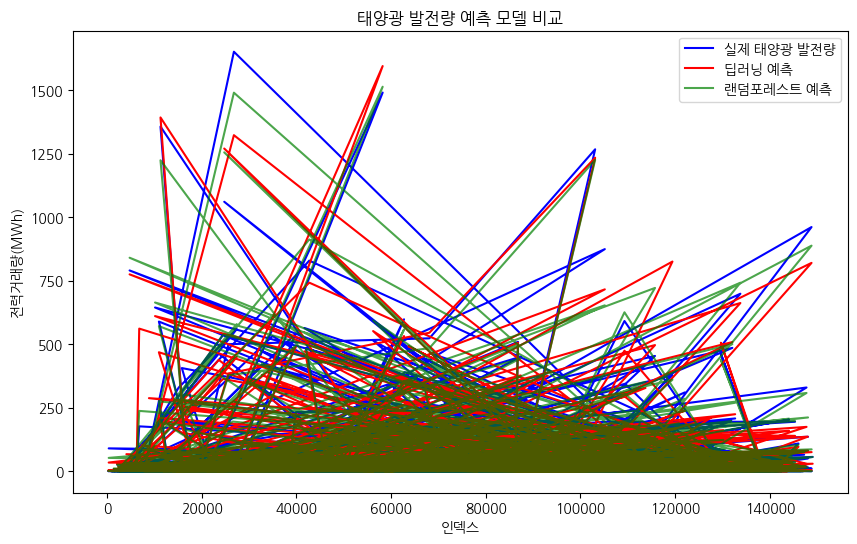

In [70]:
from sklearn.metrics import mean_squared_error, r2_score
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam
from sklearn.preprocessing import StandardScaler
import numpy as np

# 데이터 전처리 (기존 코드와 동일한 특성 사용)
# 스케일링 (딥러닝에는 매우 중요)
scaler_X = StandardScaler()
scaler_y = StandardScaler()

X_train_scaled = scaler_X.fit_transform(X_train)
X_test_scaled = scaler_X.transform(X_test)

y_train_scaled = scaler_y.fit_transform(
    y_train.values.reshape(-1, 1)).flatten()
y_test_scaled = scaler_y.transform(y_test.values.reshape(-1, 1)).flatten()

# 딥러닝 모델 구축
model_keras = Sequential([
  Dense(128, activation='relu', input_shape=(X_train_scaled.shape[1],)),
  BatchNormalization(),
  Dropout(0.3),
  Dense(64, activation='relu'),
  BatchNormalization(),
  Dropout(0.2),
  Dense(32, activation='relu'),
  Dense(1)
])

model_keras.compile(
  optimizer=Adam(learning_rate=0.001),
  loss='mse',
  metrics=['mae', tf.keras.metrics.RootMeanSquaredError()]
)

# 콜백 설정
early_stopping = EarlyStopping(
  monitor='val_loss',
  patience=10,
  restore_best_weights=True
)

# 모델 학습
history = model_keras.fit(
  X_train_scaled, y_train_scaled,
  epochs=50,
  batch_size=64,
  validation_split=0.2,
  callbacks=[early_stopping],
  verbose=1
)

# 예측 및 평가
y_pred_scaled = model_keras.predict(X_test_scaled)
y_pred = scaler_y.inverse_transform(y_pred_scaled)

# 모델 성능 평가

mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print(f'딥러닝 모델 성능:')
print(f'RMSE: {rmse:.4f}')
print(f'R² Score: {r2:.4f}')
print(f'\n랜덤 포레스트와 비교:')
print(f'랜덤 포레스트 R² Score: {test_score:.4f}')
print(f'딥러닝 모델 R² Score: {r2:.4f}')

# 학습 과정 시각화
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss During Training')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['root_mean_squared_error'], label='RMSE (Train)')
plt.plot(history.history['val_root_mean_squared_error'], label='RMSE (Val)')
plt.title('RMSE During Training')
plt.xlabel('Epochs')
plt.ylabel('RMSE')
plt.legend()
plt.tight_layout()
plt.show()

# 예측 결과 비교 시각화
plt.figure(figsize=(10, 6))
plt.plot(y_test.index[:500], y_test.values[:500],
         label='실제 태양광 발전량', color='blue')
plt.plot(y_test.index[:500], y_pred[:500], label='딥러닝 예측', color='red')
plt.plot(y_test.index[:500], model.predict(X_test[:500]),
         label='랜덤포레스트 예측', color='green', alpha=0.7)
plt.title('태양광 발전량 예측 모델 비교')
plt.xlabel('인덱스')
plt.ylabel('전력거래량(MWh)')
plt.legend()
plt.show()

In [63]:
X_test.head()

,평균기온(°C),일강수량(mm),평균 상대습도(%),강수 계속시간(hr),최고기온(°C),거래시간,월,일,계절,시간_정규화
70112,0.0,0.0,0.0,0.0,0.0,9,6,20,2,0.375000
66921,23.2,3.6,66.8,0.0,36.2,10,6,13,2,0.416667
86432,0.0,0.0,0.0,0.0,0.0,9,7,30,3,0.375000
109050,21.8,0.0,69.1,0.0,26.8,19,9,24,3,0.791667
24705,-2.4,0.0,44.3,0.0,2.1,10,3,1,1,0.416667


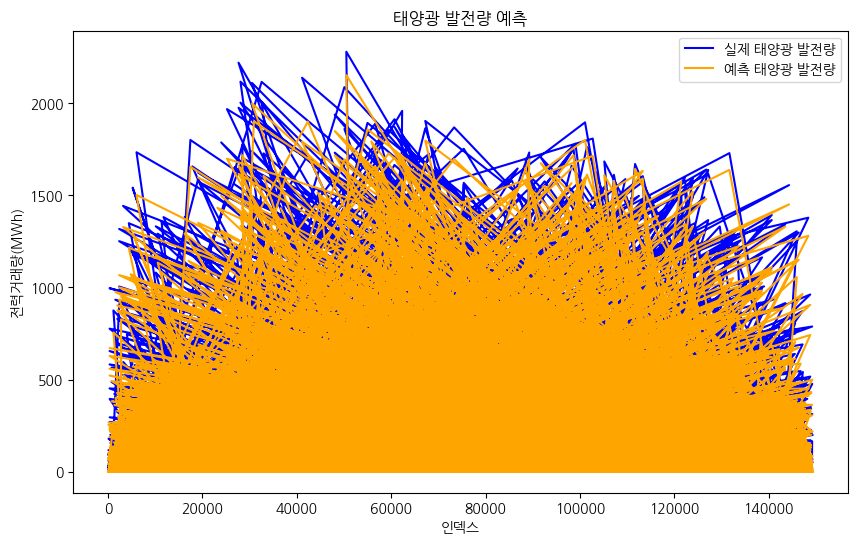

In [67]:
import matplotlib.pyplot as plt
model.predict(X_test.head())
# 예측 결과 시각화
# 예측 결과 시각화
plt.figure(figsize=(10, 6))
plt.plot(y_test.index, y_test, label='실제 태양광 발전량', color='blue')
plt.plot(y_test.index, model.predict(X_test),
         label='예측 태양광 발전량', color='orange')
plt.title('태양광 발전량 예측')
plt.xlabel('인덱스')
plt.ylabel('전력거래량(MWh)')
plt.legend()
plt.show()